In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pickle
import analyze_lpj_output as analysis
import europe_plots as ep
import optimization_plots as oplot
import variable_units as vu
import helper.plot_helpers as ploh
from mpl_toolkits.axes_grid1 import make_axes_locatable
import string


import optimization_europe_aggregation as oagg
import optimization_setup as osetup
from matplotlib import colors

from plotly.subplots import make_subplots

In [2]:
used_simulations = ['base', 'toBd', 'toBe', 'toCoppice', 'toNe', 'unmanaged']

In [3]:
with open('optimization_datasets/optimized_2024_07_04_09_14_32_FINAL_REVISED_PAPER_NO_CONSTRAINTS.dat', 'rb') as handle:
    optimized_all_gcs_no_constraint = pickle.load(handle)
with open('optimization_datasets/optimized_2024_07_04_08_47_44_FINAL_REVISED_PAPER_HARV_SUM.dat', 'rb') as handle:
    optimized_all_gcs_harvest_constraint = pickle.load(handle)
with open('optimization_datasets/optimized_2024_07_04_08_58_27_FINAL_REVISED_PAPER_HARV_HLP_SUM.dat', 'rb') as handle:
    optimized_all_gcs_harvest_hlp_constraint = pickle.load(handle)
with open('optimization_datasets/optimized_2024_07_03_23_49_20_FINAL_REVISED_PAPER_ALL_CONSTRAINTS_SUM.dat', 'rb') as handle:
    optimized_all_gcs_harvest_hlp_unmanaged_constraint = pickle.load(handle)
with open('optimization_datasets/optimized_2024_07_03_23_59_03_FINAL_REVISED_PAPER_ALL_CONSTRAINTS_MINMAX.dat', 'rb') as handle:
    optimized_all_gcs_harvest_hlp_unmanaged_constraint_minmax = pickle.load(handle)

In [4]:
def plot_result(result, save_for_paper_path_aggregated=None, save_for_paper_path_detailed=None):
    df = []
    for cell_result in result:
        ddff = pd.DataFrame(cell_result['row']).transpose()
        ddff['feasible'] = True
        df.append(ddff)

    all_pies = ep.plot_portfolios_on_map(pd.concat(df), lambda_opt=0.2, print_cell_info=True,
                                       save_for_paper_path=save_for_paper_path_detailed).set_index(['Lon', 'Lat'])
    aggregated = ep.plot_europe_with_pies(all_pies, save_for_paper_path=save_for_paper_path_aggregated)

    return all_pies, aggregated

did not find a region for 0 cells


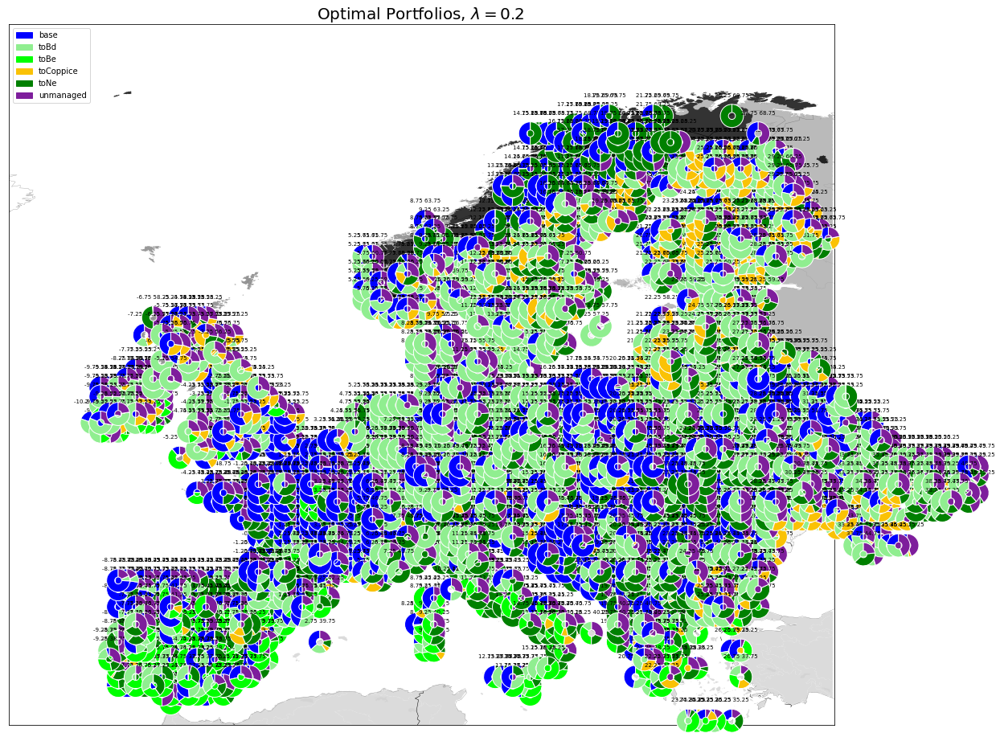

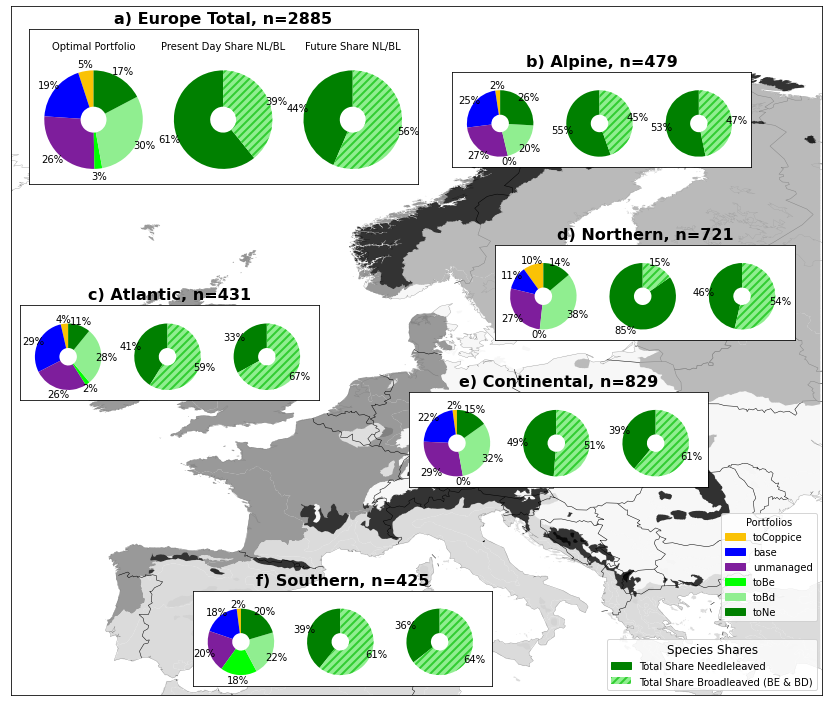

In [5]:
all_pfs_no_constraint, shares_no_constraint = plot_result(optimized_all_gcs_no_constraint)

did not find a region for 0 cells


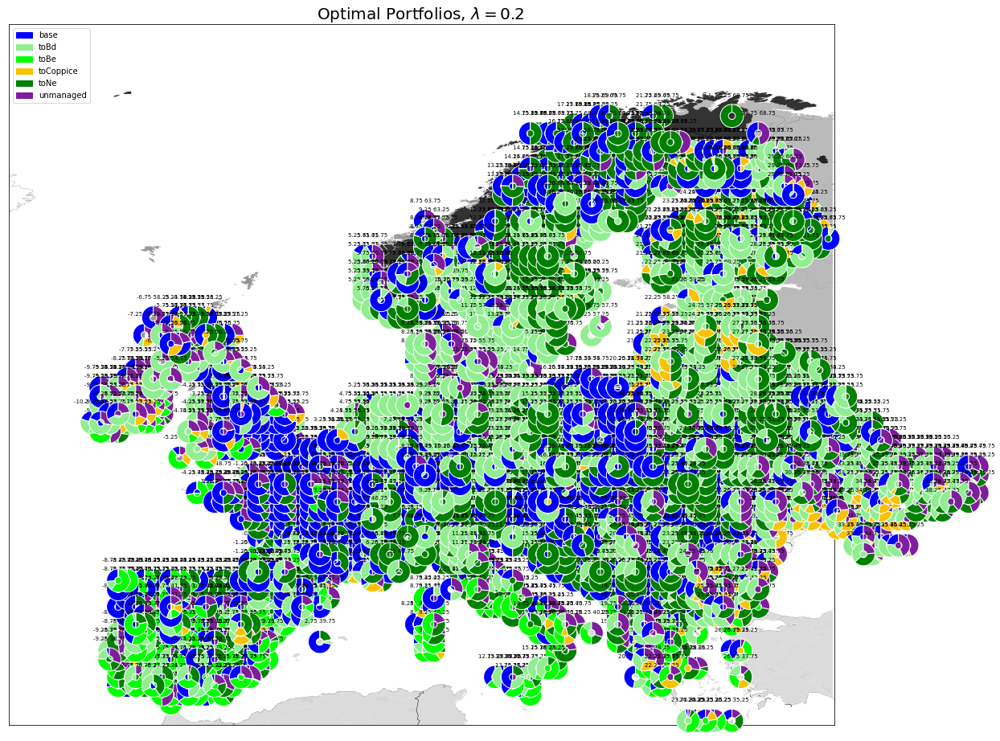

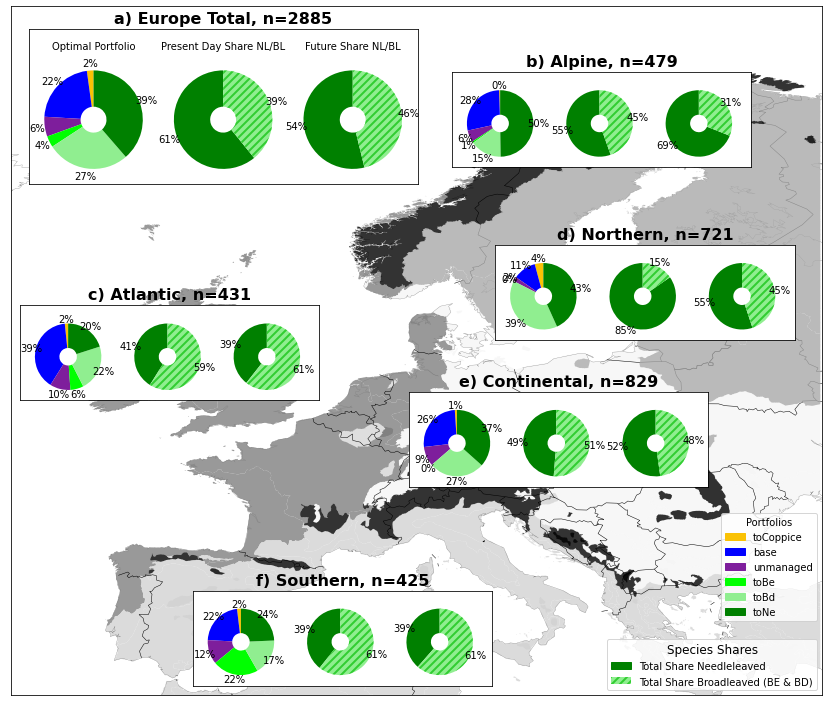

In [6]:
all_pfs_harvest_constraint, shares_harvest_constraint = plot_result(optimized_all_gcs_harvest_constraint)

did not find a region for 0 cells


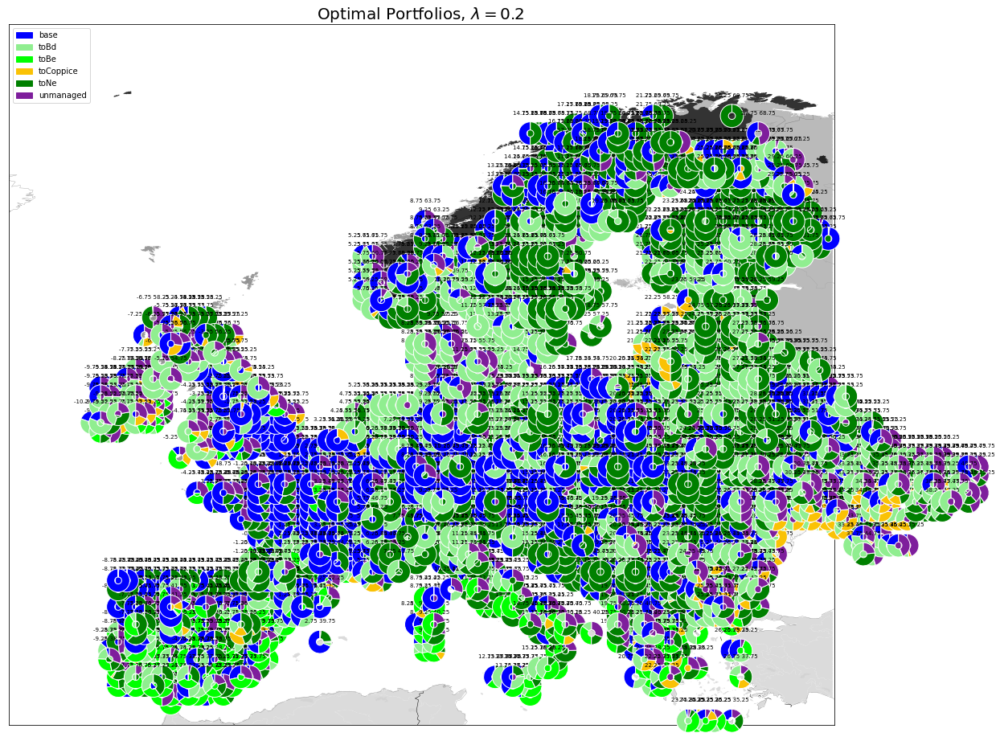

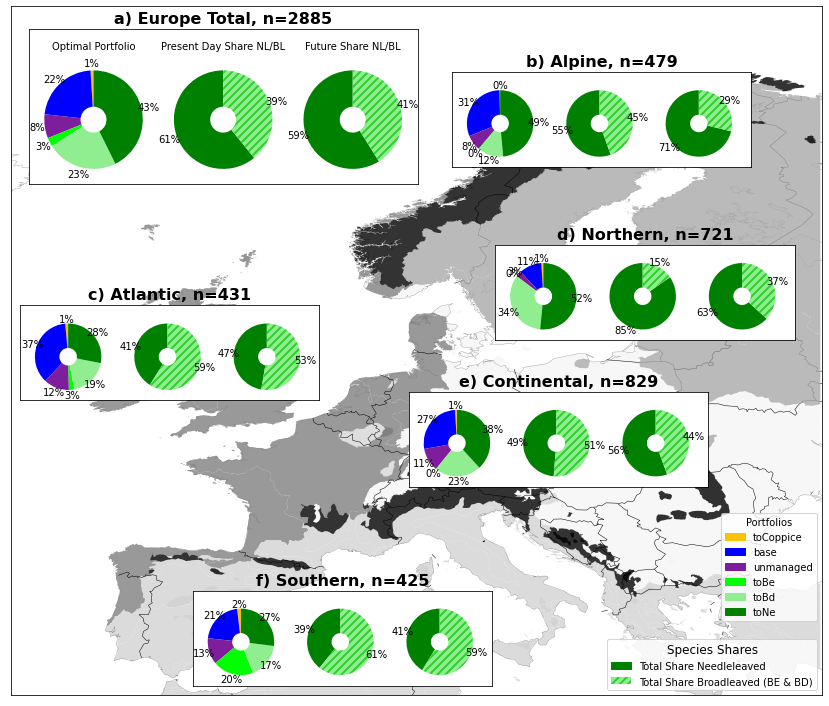

In [7]:
all_pfs_hlp_constraint, shares_hlp_constraint = plot_result(optimized_all_gcs_harvest_hlp_constraint)

did not find a region for 0 cells


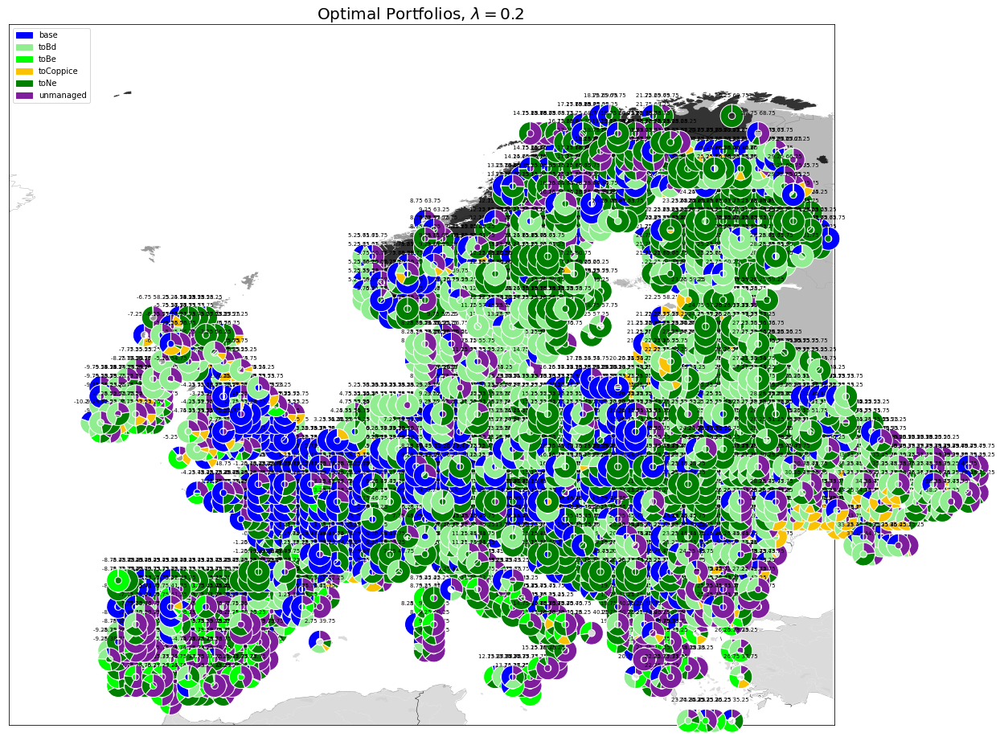

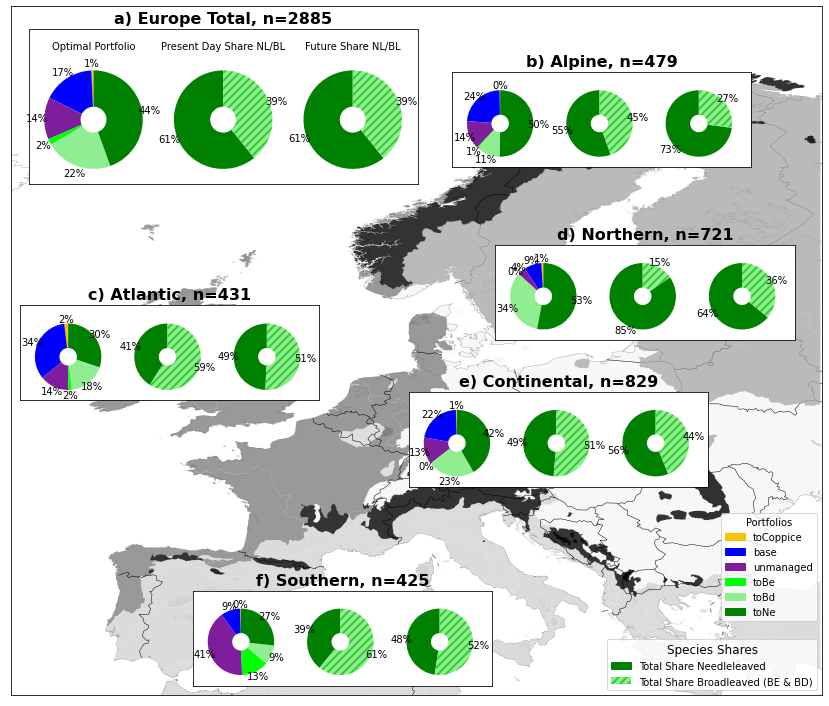

In [8]:
all_pfs_harvest_hlp_unmanaged_constraint, shares_harvest_hlp_unmanaged_constraint = plot_result(optimized_all_gcs_harvest_hlp_unmanaged_constraint)

did not find a region for 0 cells


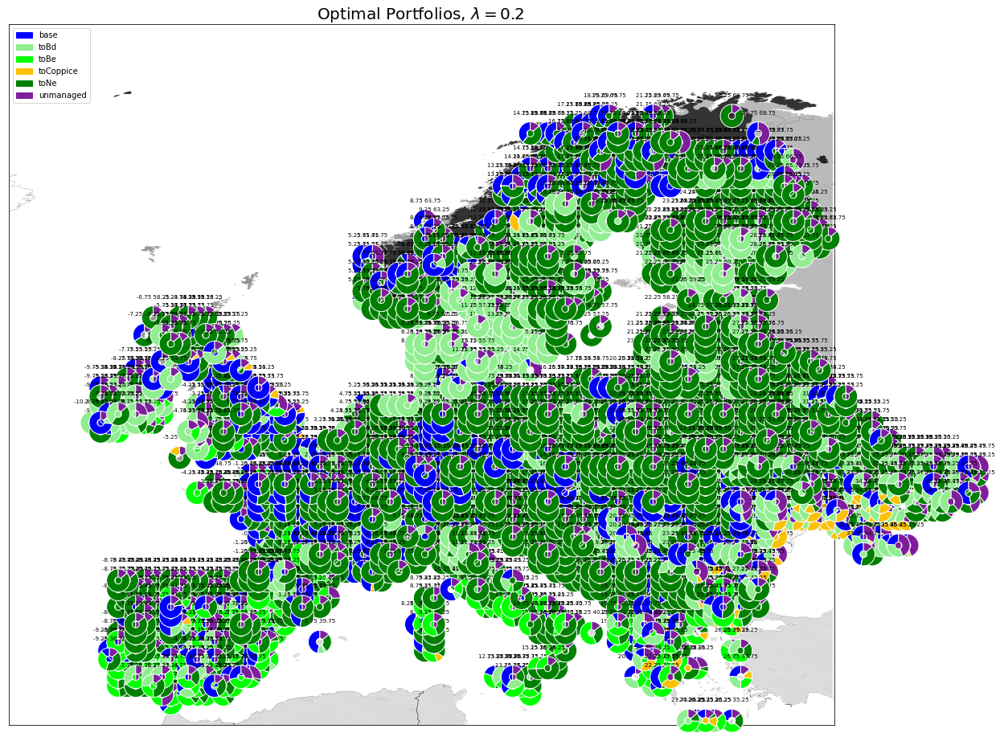

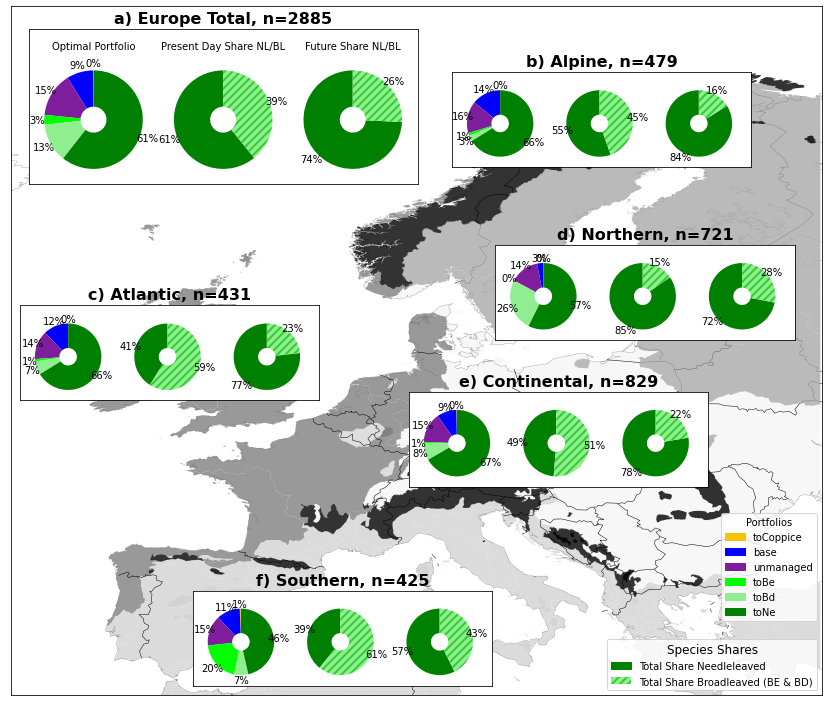

In [9]:
with open('optimization_datasets/optimized_2024_07_04_11_46_46_FINAL_REVISED_PAPER_ALL_CONSTRAINTS_UNMANAGED_CELL_95_harv.dat', 'rb') as handle:
    optimized_all_gcs_harvest95_hlp_unmanaged_cell_constraint = pickle.load(handle)
_, _ = plot_result(optimized_all_gcs_harvest95_hlp_unmanaged_cell_constraint, save_for_paper_path_aggregated='supplement_figs/unmanaged_cell_high_ne.png')

# EU Portfolios

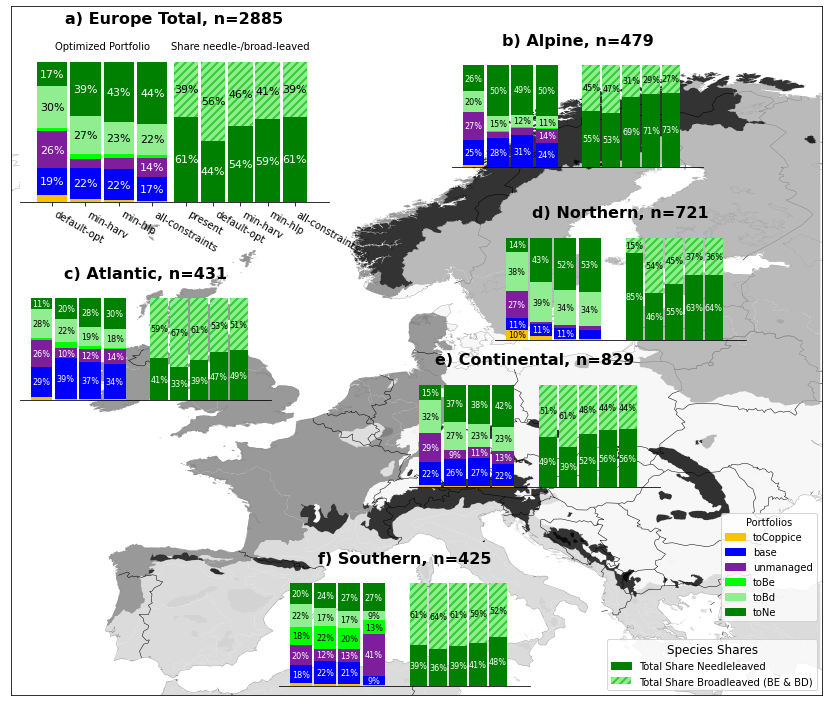

In [10]:
pffs = {
    'default-opt': all_pfs_no_constraint,
    'min-harv': all_pfs_harvest_constraint,
    'min-hlp': all_pfs_hlp_constraint,
    'all-constraints': all_pfs_harvest_hlp_unmanaged_constraint
}

shares2 = ep.plot_europe_with_bars_and_compare(pffs, save_for_paper_path='paper_figs/compare_portfolios_europe_final_revision.png')

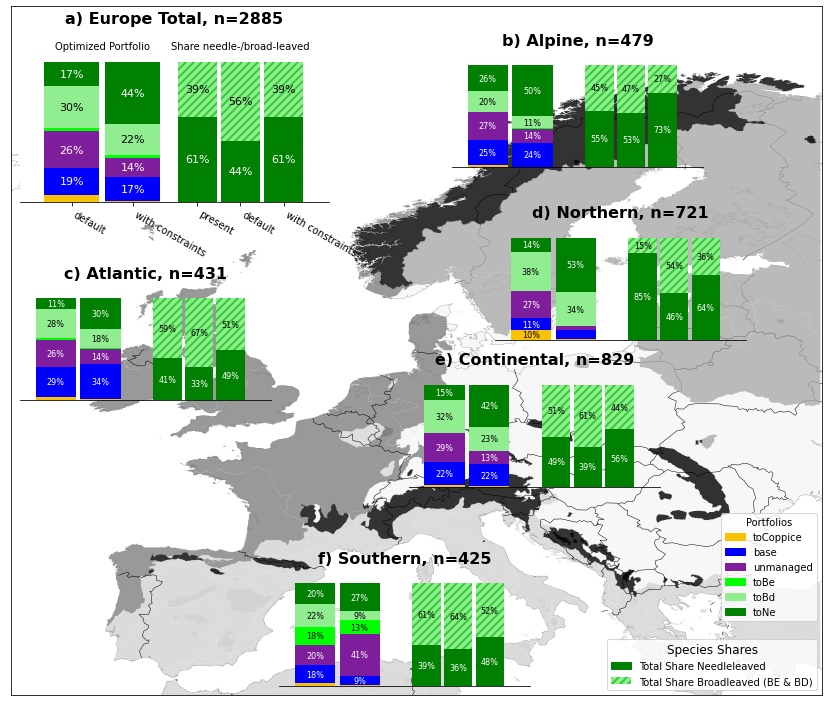

In [11]:
pffs = {
    'default': all_pfs_no_constraint,
    'with constraints': all_pfs_harvest_hlp_unmanaged_constraint
}

_ = ep.plot_europe_with_bars_and_compare(pffs, save_for_paper_path='paper_figs/compare_portfolios_europe_final_revision_simplified.png')

# ES Provision

## One Grid Cell

In [12]:
for idx, cell_out in enumerate(optimized_all_gcs_harvest_hlp_unmanaged_constraint):
    if((cell_out['row']['Lon'], cell_out['row']['Lat']) in [(23.75, 61.75)]):
        cell_out2 = optimized_all_gcs_no_constraint[idx]
        cell_out['row'][2] = 'Southern Finland'
        cell_out2['row'][2] = 'Southern Finland'
        oplot.plot_optimization_results2(cell_out2, luyssaert=False, radar=True, simulations_of_interest=[x for x in used_simulations if x != 'toBe' and x != 'base'], save_to=None, portfolioname='default-opt')
        oplot.plot_optimization_results2(cell_out, luyssaert=False, radar=True, simulations_of_interest=[x for x in used_simulations if x != 'toBe' and x != 'base'], save_to=None, row_nr=2/3, portfolioname='all-constraints')

## Multi-functionality across grid cells

In [13]:
gc_worst_cases = []

radar = True
col_widths = None if radar else [0.45, 0.3, 0.25]

fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'polar' if radar else 'xy'}, {'type': 'polar' if radar else 'xy'}]], column_widths=col_widths,
                    subplot_titles=("No constraints", "All constraints"),
                    shared_yaxes=True, vertical_spacing=0.5)

i_ones = 0
gc_ones = []

typical_harvest_values = []


es_full_names = {
    'harvest' : 'All harvests (harvest)',
    'hlp' : 'Harvests for long-lived products (hlp)',
    'mitigation' : 'Carbon mitigation (mitigation)',
    'et' : 'Evapotranspiration (et)',
    'surface_roughness' : 'Surface roughness (surface_roughness)',
    'swp' : ' (swp)',
    'biodiversity_combined' : ' (biodiversity_combined)',
}

for run_idx, run in enumerate([optimized_all_gcs_no_constraint, optimized_all_gcs_harvest_hlp_unmanaged_constraint]):

    for cell_out in run:
        es_list = cell_out['es']
        simulation_list = cell_out['all_managements']
        all_es_vals = cell_out['es_vals_all_rcps_new']
        optimized_solution = cell_out['all_rcp_solution_new']
        rcps = cell_out['rcps']
        gridcell = cell_out['row']

        portfolio_fractions = cell_out['all_rcp_solution_new'].x[1:]
        portfolio_worst = np.ones(len(es_list))
        for idx, rcp in enumerate(rcps):
            vals_for_rcp = all_es_vals[idx::len(rcps)]
            optimized_scores = np.dot(portfolio_fractions, np.transpose(vals_for_rcp))
            portfolio_worst = np.minimum(portfolio_worst, optimized_scores)

        oplot.my_plot_radar_chart(fig, list(es_list), ['optimal portfolio'], portfolio_worst, 1, run_idx+1, with_transparency=True, full_names_with_abb=True)


fig.update_polars(radialaxis=dict(range=[0, 1], showticklabels=True, showline=False), gridshape='circular')

fig.update_xaxes(tickangle=45)
fig.update_layout(boxmode='group')
fig.update_annotations(yshift=20)
fig.show()

fig.write_image('paper_figs/all_cells_es_provision.png', format='png', scale=1, width=1200)

## Diffs

In [14]:
run_dir = '/media/konni/bfm-work-ext1/konstantin/constrained_opt/revision_runs_full_eu_for_zenodo_fullsets/'

rcp26_simulations = dict(
    base=run_dir + 'base_rcp26/',
    toBd=run_dir + 'tobd_rcp26/',
    toBe=run_dir + 'tobe_rcp26/',
    toCoppice=run_dir + 'toCoppice_rcp26/',
    toNe=run_dir + 'tone_rcp26/',
    unmanaged=run_dir + 'unmanaged_rcp26/',
)

rcp45_simulations = dict(
    base=run_dir + 'base_rcp45/',
    toBd=run_dir + 'tobd_rcp45/',
    toBe=run_dir + 'tobe_rcp45/',
    toCoppice=run_dir + 'toCoppice_rcp45/',
    toNe=run_dir + 'tone_rcp45/',
    unmanaged=run_dir + 'unmanaged_rcp45/',
)

rcp60_simulations = dict(
    base=run_dir + 'base_rcp60/',
    toBd=run_dir + 'tobd_rcp60/',
    toBe=run_dir + 'tobe_rcp60/',
    toCoppice=run_dir + 'toCoppice_rcp60/',
    toNe=run_dir + 'tone_rcp60/',
    unmanaged=run_dir + 'unmanaged_rcp60/',
)

rcp85_simulations = dict(
    base=run_dir + 'base_rcp85/',
    toBd=run_dir + 'tobd_rcp85/',
    toBe=run_dir + 'tobe_rcp85/',
    toCoppice=run_dir + 'toCoppice_rcp85/',
    toNe=run_dir + 'tone_rcp85/',
    unmanaged=run_dir + 'unmanaged_rcp85/',
)

simulations = {'rcp26': rcp26_simulations, 'rcp45': rcp45_simulations, 'rcp60': rcp60_simulations,
               'rcp85': rcp85_simulations}

In [15]:
def plot_diffs_for_main_figure(portfolios1, portfolios2, ess, rcp, boundaries, diffmin=None, diffmax=None, cmap=None, save_for_paper=False):

    assert np.all(portfolios1['feasible']), "not all grid cells were feasible"
    assert np.all(portfolios2['feasible']), "not all grid cells were feasible"

    lonlats = portfolios1.index.values


    fig, ax = plt.subplots(2,3, figsize=(16, 6))
    fig.tight_layout()


    for idx, es in enumerate(ess):

        relevant_management_options1 = portfolios1.copy()[osetup.used_simulations]
        relevant_management_options2 = portfolios2.copy()[osetup.used_simulations]
        cpools = pd.DataFrame(index=relevant_management_options1.index)
        for sim in osetup.used_simulations:
            cpools[sim] = oagg.get_es_value(simulations[rcp][sim], es, 2100, 2130, lons_lats_of_interest=lonlats)[oagg.es_variable_names[es]]
        cpools['optimized1'] = cpools.mul(relevant_management_options1).sum(axis=1)
        cpools['optimized2'] = cpools.mul(relevant_management_options2).sum(axis=1)
        cpools['present'] = oagg.get_es_value(simulations[rcp]['base'], es, 2000, 2010, lons_lats_of_interest=lonlats)[oagg.es_variable_names[es]]

        # Diff min-harv - default-opt, Diff min-harv - present

        print('ES', analysis.compute_total_value(cpools, ['present', 'optimized2'], lon_frac=2, lat_frac=2))

        diff_norm = colors.TwoSlopeNorm(vcenter=0, vmin=diffmin, vmax=diffmax)

        sc_diff = ep.plot_on_map(cpools.index.get_level_values('Lon'), cpools.index.get_level_values('Lat').values, cpools['optimized2'].values - cpools['optimized1'].values, ax[0, idx], 'RdBu', norm=diff_norm, s=5, relief=False, countrylines=True)
        ax[0, idx].set_title(oagg.table_names[es] + '\nall-constraints - default-opt (2100$-$2130)')

        ep.plot_on_map(cpools.index.get_level_values('Lon'), cpools.index.get_level_values('Lat').values, cpools['optimized2'].values - cpools['present'].values, ax[1, idx], 'RdBu', norm=diff_norm, s=5, relief=False, countrylines=True)
        ax[1, idx].set_title(oagg.table_names[es] + '\nall-constraints (2100$-$2130) - present ')



        margin='5%'
        padding=0.05

        divider = make_axes_locatable(ax[0, idx])
        cax = divider.append_axes("right", size=margin, pad=padding)
        cb = plt.colorbar(sc_diff, cax=cax)
        cb.set_label(vu.variable_units_unconverted[es], labelpad=-1)
        divider = make_axes_locatable(ax[1, idx])
        cax = divider.append_axes("right", size=margin, pad=padding)
        cb = plt.colorbar(sc_diff, cax=cax)
        cb.set_label(vu.variable_units_unconverted[es], labelpad=-1)


    letter_idx=0
    for idx1, axx in enumerate(ax):
        for idx2, axxx in enumerate(axx):
            axxx.text(-0.15, 1.05, string.ascii_lowercase[letter_idx]+')', transform=axxx.transAxes, size=12, weight='bold')
            letter_idx+=1


    if save_for_paper:
        fig.savefig(save_for_paper, dpi=fig.dpi,bbox_inches='tight')

ES present       9.082055e+13
optimized2    1.056697e+14
dtype: float64
ES present       8.415667e+13
optimized2    7.795797e+13
dtype: float64
ES present       2.164427e+14
optimized2    2.323478e+14
dtype: float64


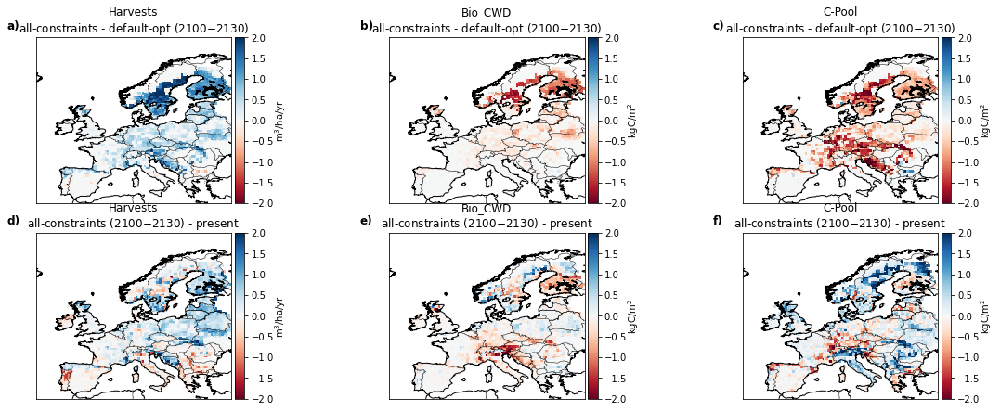

In [16]:
plot_diffs_for_main_figure(all_pfs_no_constraint, all_pfs_harvest_hlp_unmanaged_constraint, ['harvest', 'biodiversity_cwd', 'cpool'], 'rcp45', np.array([0, 2, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]), -2, 2, save_for_paper='paper_figs/es_provision_diffs45.png')

ES present       9.340247e+13
optimized2    9.717291e+13
dtype: float64
ES present       8.413944e+13
optimized2    8.322206e+13
dtype: float64
ES present       2.175977e+14
optimized2    2.289841e+14
dtype: float64


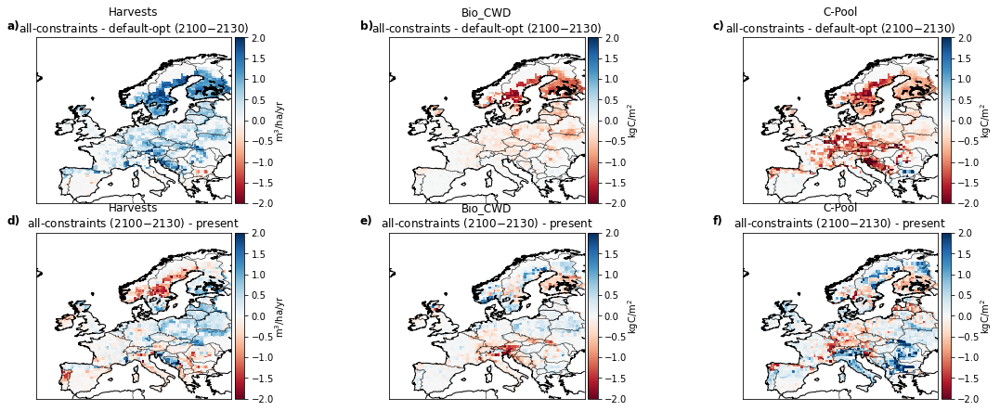

In [17]:
plot_diffs_for_main_figure(all_pfs_no_constraint, all_pfs_harvest_hlp_unmanaged_constraint, ['harvest', 'biodiversity_cwd', 'cpool'], 'rcp26', np.array([0, 2, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]), -2, 2, save_for_paper='supplement_figs/es_provision_diffs26.png')

ES present       9.282351e+13
optimized2    1.180170e+14
dtype: float64
ES present       8.420454e+13
optimized2    7.650678e+13
dtype: float64
ES present       2.172160e+14
optimized2    2.463859e+14
dtype: float64


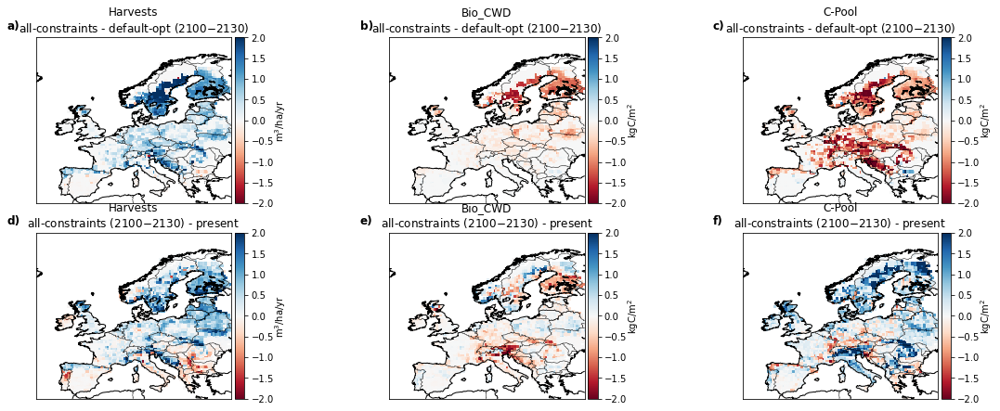

In [18]:
plot_diffs_for_main_figure(all_pfs_no_constraint, all_pfs_harvest_hlp_unmanaged_constraint, ['harvest', 'biodiversity_cwd', 'cpool'], 'rcp60', np.array([0, 2, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]), -2, 2, save_for_paper='supplement_figs/es_provision_diffs60.png')

ES present       9.382265e+13
optimized2    1.201674e+14
dtype: float64
ES present       8.421017e+13
optimized2    6.951090e+13
dtype: float64
ES present       2.178050e+14
optimized2    2.394815e+14
dtype: float64


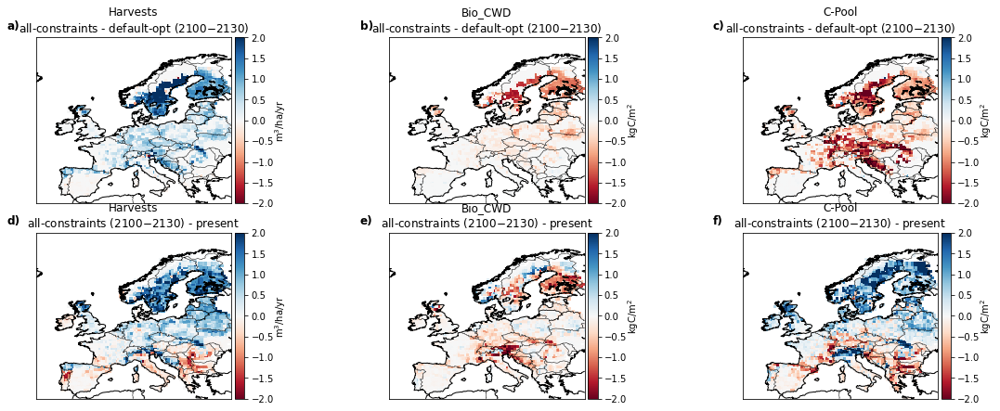

In [19]:
plot_diffs_for_main_figure(all_pfs_no_constraint, all_pfs_harvest_hlp_unmanaged_constraint, ['harvest', 'biodiversity_cwd', 'cpool'], 'rcp85', np.array([0, 2, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]), -2, 2, save_for_paper='supplement_figs/es_provision_diffs85.png')

## Carbon sink of unconstrained opt

ES present       9.082055e+13
optimized2    7.670488e+13
dtype: float64
ES present       8.415667e+13
optimized2    9.078967e+13
dtype: float64
ES present       2.164427e+14
optimized2    2.618944e+14
dtype: float64


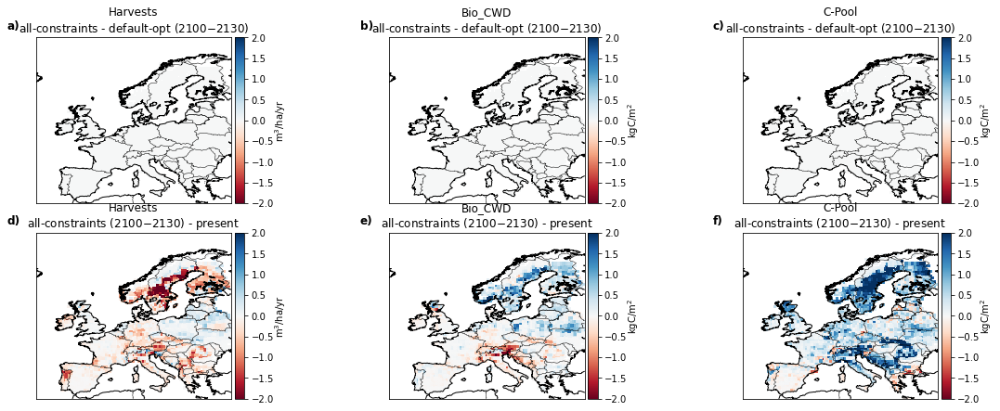

In [20]:
plot_diffs_for_main_figure(all_pfs_no_constraint, all_pfs_no_constraint, ['harvest', 'biodiversity_cwd', 'cpool'], 'rcp45', np.array([0, 2, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]), -2, 2, save_for_paper=None)

## Unmanaged Cells

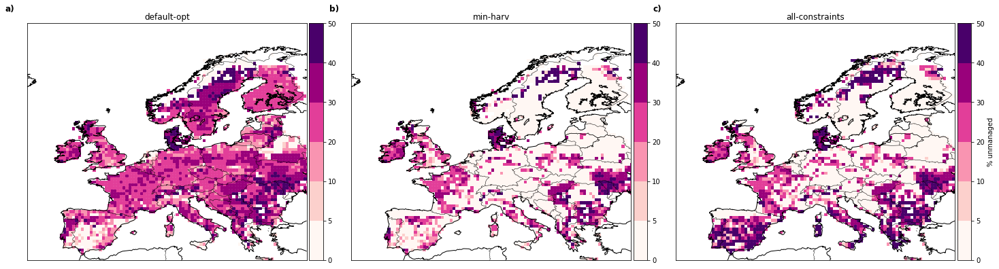

In [21]:
fig, ax = plt.subplots(1,3, figsize=(20, 8))
fig.tight_layout()

boundaries = [0.0, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5]
cmap = ploh.discrete_cmap(len(boundaries)-1, 'RdPu')
my_norm = colors.BoundaryNorm(boundaries, cmap.N, clip=True)

square_size = 12

sc1 = ep.plot_on_map(all_pfs_no_constraint.index.get_level_values('Lon'), all_pfs_no_constraint.index.get_level_values('Lat').values, all_pfs_no_constraint['unmanaged'].values, ax[0], s=square_size, relief=False, countrylines=True, norm=my_norm, cmap=cmap)
ax[0].set_title('default-opt')
sc2 = ep.plot_on_map(all_pfs_harvest_constraint.index.get_level_values('Lon'), all_pfs_harvest_constraint.index.get_level_values('Lat').values, all_pfs_harvest_constraint['unmanaged'].values, ax[1], s=square_size, relief=False, countrylines=True, norm=my_norm, cmap=cmap)
ax[1].set_title('min-harv')
sc3 = ep.plot_on_map(all_pfs_harvest_hlp_unmanaged_constraint.index.get_level_values('Lon'), all_pfs_harvest_hlp_unmanaged_constraint.index.get_level_values('Lat').values, all_pfs_harvest_hlp_unmanaged_constraint['unmanaged'].values, ax[2], s=square_size, relief=False, countrylines=True, norm=my_norm, cmap=cmap)
ax[2].set_title('all-constraints')


margin='5%'
padding=0.05

for idx, axx in enumerate(ax):
    divider = make_axes_locatable(axx)
    cax = divider.append_axes("right", size=margin, pad=padding)
    cb = plt.colorbar(sc1, cax=cax)
    cb.set_ticklabels(['{:.0f}'.format(boundary*100) for boundary in boundaries])
    if idx == 2:
        cb.set_label('% unmanaged')
    axx.text(-0.08, 1.05, string.ascii_lowercase[idx]+')', transform=axx.transAxes, size=12, weight='bold')

fig.savefig('paper_figs/unmanaged_cells.png', dpi=fig.dpi,bbox_inches='tight')

## Cells without unmanaged forest

In [22]:
len(all_pfs_no_constraint[all_pfs_no_constraint['unmanaged']<0.0001])/len(all_pfs_no_constraint)

0.07625649913344887

In [23]:
len(all_pfs_harvest_constraint[all_pfs_harvest_constraint['unmanaged']<0.0001])/len(all_pfs_harvest_constraint)

0.5837088388214905

In [24]:
len(all_pfs_harvest_hlp_unmanaged_constraint[all_pfs_harvest_hlp_unmanaged_constraint['unmanaged']<0.0001])/len(all_pfs_harvest_hlp_unmanaged_constraint)

0.47694974003466206

## Cells with unmanaged forest < 13.8%

In [25]:
len(all_pfs_no_constraint[all_pfs_no_constraint['unmanaged']<0.138])/len(all_pfs_no_constraint)

0.14974003466204505

In [26]:
len(all_pfs_harvest_hlp_unmanaged_constraint[all_pfs_harvest_hlp_unmanaged_constraint['unmanaged']<0.138])/len(all_pfs_harvest_hlp_unmanaged_constraint)

0.5209705372616984

# Portfolio Diversity

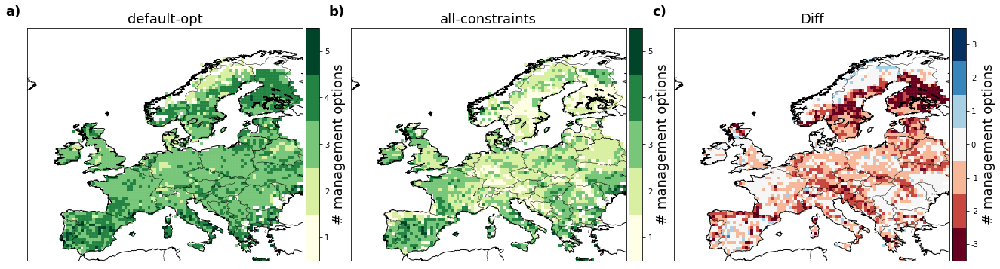

In [27]:
def get_number_of_portfolios(pfs):
    pfs_copy = pfs[used_simulations].copy()
    pfs_copy[pfs_copy > 0.0001] = 1
    pfs_copy['number_of_man'] = pfs_copy.sum(axis=1)
    return pfs_copy


fig, ax = plt.subplots(1,3, figsize=(18, 8))
fig.tight_layout()

boundaries = [0.5, 1.5, 2.5, 3.5, 4.5, 5.5]
cmap = ploh.discrete_cmap(len(boundaries)-1, 'YlGn')
my_norm = colors.BoundaryNorm(boundaries, cmap.N, clip=True)


all_pfs_sum_no_constraint_n_portfolios = get_number_of_portfolios(all_pfs_no_constraint)
all_pfs_sum_harv_constraint_n_portfolios = get_number_of_portfolios(all_pfs_harvest_hlp_unmanaged_constraint)

square_size = 9

sc1 = ep.plot_on_map(all_pfs_sum_no_constraint_n_portfolios.index.get_level_values('Lon'), all_pfs_sum_no_constraint_n_portfolios.index.get_level_values('Lat').values, all_pfs_sum_no_constraint_n_portfolios['number_of_man'].values, ax[0], s=square_size, relief=False, countrylines=True, norm=my_norm, cmap=cmap)
ax[0].set_title('default-opt', size=18)
sc2 = ep.plot_on_map(all_pfs_sum_harv_constraint_n_portfolios.index.get_level_values('Lon'), all_pfs_sum_harv_constraint_n_portfolios.index.get_level_values('Lat').values, all_pfs_sum_harv_constraint_n_portfolios['number_of_man'].values, ax[1], s=square_size, relief=False, countrylines=True, norm=my_norm, cmap=cmap)
ax[1].set_title('all-constraints', size=18)



ticks = np.arange(1, 6, 1)
tick_labels = np.arange(1, 6, 1)

margin='5%'
padding=0.05

for axx in ax[0:2]:
    divider = make_axes_locatable(axx)
    cax = divider.append_axes("right", size=margin, pad=padding)
    cb = plt.colorbar(sc1, cax=cax, ticks=ticks)
    cb.set_ticklabels(tick_labels)
    cb.set_label('# management options', size=18)




cmap_piyg = plt.cm.get_cmap('RdBu')
num_colors = 7
values = np.linspace(-3, 3, 7)
cmap = colors.LinearSegmentedColormap.from_list('my_colormap', [cmap_piyg(value) for value in np.linspace(0, 1, num_colors)])
boundaries = np.linspace(-3.5, 3.5, num_colors + 1)
diff_norm = colors.BoundaryNorm(boundaries, cmap.N)

sc_diff = ep.plot_on_map(all_pfs_sum_no_constraint_n_portfolios.index.get_level_values('Lon'), all_pfs_sum_no_constraint_n_portfolios.index.get_level_values('Lat').values, all_pfs_sum_harv_constraint_n_portfolios['number_of_man'].values - all_pfs_sum_no_constraint_n_portfolios['number_of_man'].values, ax[2], 'RdBu', norm=diff_norm, s=square_size, countrylines=True, relief=False)
ax[2].set_title('Diff', size=18)


ticks = np.arange(-3, 4, 1)
tick_labels = np.arange(-3, 4, 1)
divider = make_axes_locatable(ax[2])
cax = divider.append_axes("right", size=margin, pad=padding)
cb = plt.colorbar(sc_diff, cax=cax, ticks=ticks)
cb.set_ticklabels(tick_labels)
cb.set_label('# management options', size=18)


for idx, axx in enumerate(ax):
    axx.text(-0.08, 1.05, string.ascii_lowercase[idx]+')', transform=axx.transAxes, size=18, weight='bold')

fig.savefig('paper_figs/less_diverse_portfolios.png', dpi=fig.dpi,bbox_inches='tight')

## Average number of options per portfolio

In [28]:
get_number_of_portfolios(all_pfs_no_constraint)['number_of_man'].mean()

3.272790294627383

In [29]:
get_number_of_portfolios(all_pfs_harvest_constraint)['number_of_man'].mean()

2.5636048871902877

In [30]:
get_number_of_portfolios(all_pfs_hlp_constraint)['number_of_man'].mean()

2.518890814558059

In [31]:
get_number_of_portfolios(all_pfs_harvest_hlp_unmanaged_constraint)['number_of_man'].mean()

2.407625649913345

# Supplementary Figures

In [32]:
def plot_present_and_diffs_one_row_only2(portfolios1, portfolios2, es, rcp, boundaries, diffmin=None, diffmax=None, cmap=None, save_for_paper=False, comparison_name=None):

    assert np.all(portfolios1['feasible']), "not all grid cells were feasible"
    assert np.all(portfolios2['feasible']), "not all grid cells were feasible"

    lonlats = portfolios1.index.values

    relevant_management_options1 = portfolios1.copy()[osetup.used_simulations]
    relevant_management_options2 = portfolios2.copy()[osetup.used_simulations]
    cpools = pd.DataFrame(index=relevant_management_options1.index)
    for sim in osetup.used_simulations:
        cpools[sim] = oagg.get_es_value(simulations[rcp][sim], es, 2100, 2130, lons_lats_of_interest=lonlats)[oagg.es_variable_names[es]]
    cpools['optimized1'] = cpools.mul(relevant_management_options1).sum(axis=1)
    cpools['optimized2'] = cpools.mul(relevant_management_options2).sum(axis=1)
    cpools['present'] = oagg.get_es_value(simulations[rcp]['base'], es, 2000, 2010, lons_lats_of_interest=lonlats)[oagg.es_variable_names[es]]

    fig, ax = plt.subplots(1,6, figsize=(24, 5))

    fig.tight_layout()

    if not cmap:
        cmap = ploh.discrete_cmap(len(boundaries)-1, 'YlGnBu')
    my_norm = colors.BoundaryNorm(boundaries, cmap.N, clip=True)

    square_size = 5
    sc1 = ep.plot_on_map(cpools.index.get_level_values('Lon'), cpools.index.get_level_values('Lat').values, cpools['present'].values, ax[0], s=square_size, norm=my_norm, cmap=cmap, relief=False, countrylines=True)
    ax[0].set_title('present')
    sc2 = ep.plot_on_map(cpools.index.get_level_values('Lon'), cpools.index.get_level_values('Lat').values, cpools['base'].values, ax[1], s=square_size, norm=my_norm, cmap=cmap, relief=False, countrylines=True)
    ax[1].set_title('base (2100$-$2130)')
    sc2 = ep.plot_on_map(cpools.index.get_level_values('Lon'), cpools.index.get_level_values('Lat').values, cpools['optimized1'].values, ax[2], s=square_size, norm=my_norm, cmap=cmap, relief=False, countrylines=True)
    ax[2].set_title('default-opt (2100$-$2130)')
    sc2 = ep.plot_on_map(cpools.index.get_level_values('Lon'), cpools.index.get_level_values('Lat').values, cpools['optimized2'].values, ax[3], s=square_size, norm=my_norm, cmap=cmap, relief=False, countrylines=True)
    ax[3].set_title(comparison_name + ' (2100$-$2130)')

    diff_norm = colors.TwoSlopeNorm(vcenter=0, vmin=diffmin, vmax=diffmax)

    sc_diff = ep.plot_on_map(cpools.index.get_level_values('Lon'), cpools.index.get_level_values('Lat').values, cpools['optimized2'].values - cpools['optimized1'].values, ax[4], 'RdBu', norm=diff_norm, s=square_size, relief=False, countrylines=True)
    ax[4].set_title('all-constraints - default-opt (2100$-$2130)')

    ep.plot_on_map(cpools.index.get_level_values('Lon'), cpools.index.get_level_values('Lat').values, cpools['optimized2'].values - cpools['present'].values, ax[5], 'RdBu', norm=diff_norm, s=square_size, relief=False, countrylines=True)
    ax[5].set_title('all-constraints (2100$-$2130) - present ')

    for idx, axx in enumerate(ax):
        axx.text(-0.08, 1.05, string.ascii_lowercase[idx]+')', transform=axx.transAxes, size=12, weight='bold')

    margin='5%'
    padding=0.05

    divider = make_axes_locatable(ax[0])
    cax = divider.append_axes("right", size=margin, pad=padding)
    cb = plt.colorbar(sc1, cax=cax)
    cb.set_label(vu.variable_units_unconverted[es], labelpad=-1.4)


    divider = make_axes_locatable(ax[1])
    divider.append_axes("right", size=margin, pad=padding, visible=False)
    divider = make_axes_locatable(ax[2])
    divider.append_axes("right", size=margin, pad=padding, visible=False)

    divider = make_axes_locatable(ax[4])
    cax = divider.append_axes("right", size=margin, pad=padding)
    cb = plt.colorbar(sc_diff, cax=cax)
    cb.set_label(vu.variable_units_unconverted[es], labelpad=-1)

    if save_for_paper:
        fig.savefig(save_for_paper, dpi=fig.dpi,bbox_inches='tight')

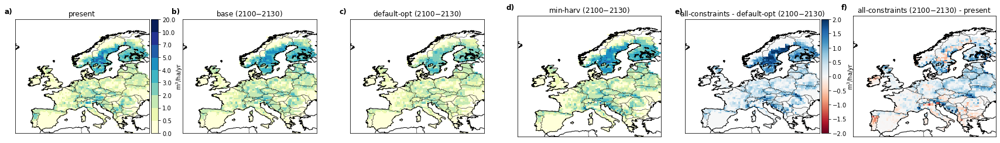

In [33]:
plot_present_and_diffs_one_row_only2(all_pfs_no_constraint, all_pfs_harvest_constraint, 'harvest', 'rcp45', np.array([0, 0.5, 1, 2, 3, 4, 5, 7, 10, 20]), -2, 2, save_for_paper='supplement_figs/harvest_provision_sum_default_maintain_harv45.png', comparison_name='min-harv')

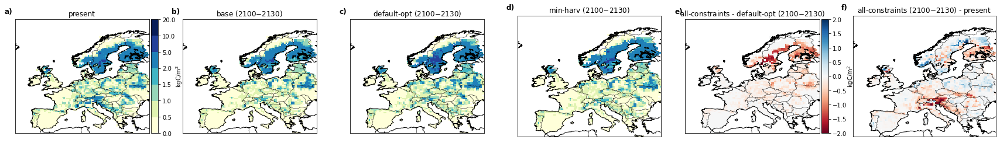

In [34]:
plot_present_and_diffs_one_row_only2(all_pfs_no_constraint, all_pfs_harvest_constraint, 'biodiversity_cwd', 'rcp45', np.array([0, 0.5, 1, 1.5, 2, 5, 10, 20]), -2, 2, save_for_paper='supplement_figs/cwd_provision_sum_default_maintain_harv45.png', comparison_name='min-harv')

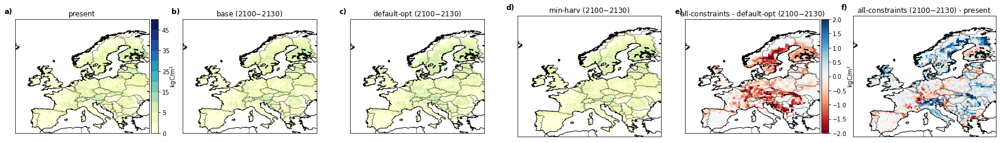

In [35]:
plot_present_and_diffs_one_row_only2(all_pfs_no_constraint, all_pfs_harvest_constraint, 'cpool', 'rcp45', np.array([0, 2, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50]), -2, 2, save_for_paper='supplement_figs/cpool_provision_sum_default_maintain_harv45.png', comparison_name='min-harv')

# SUM vs MINMAX

did not find a region for 0 cells


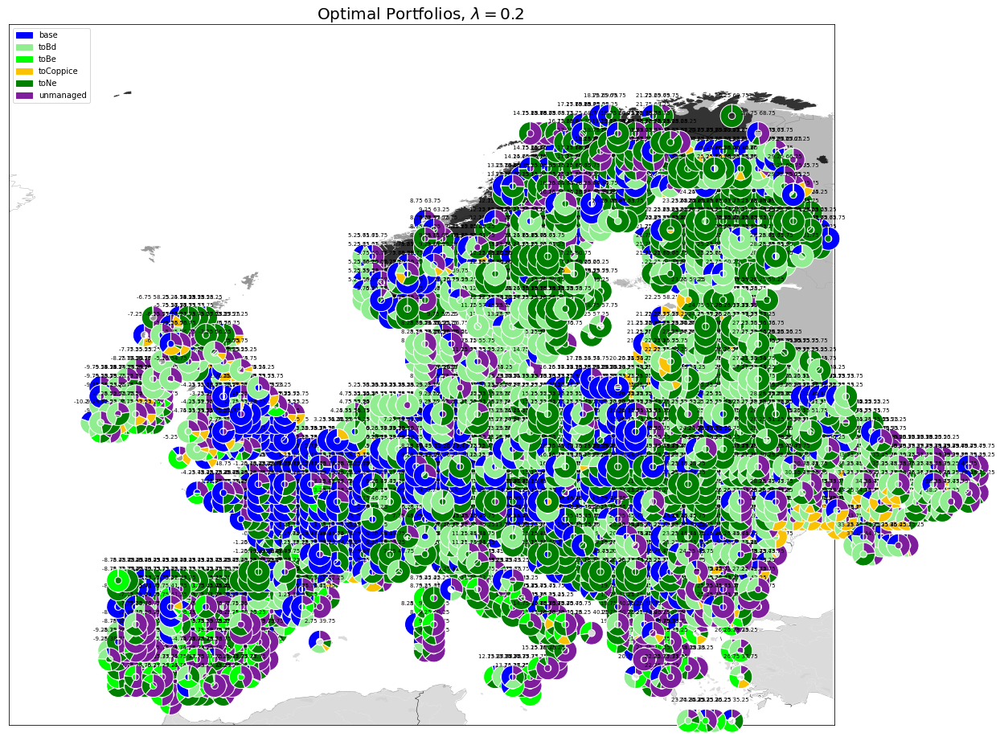

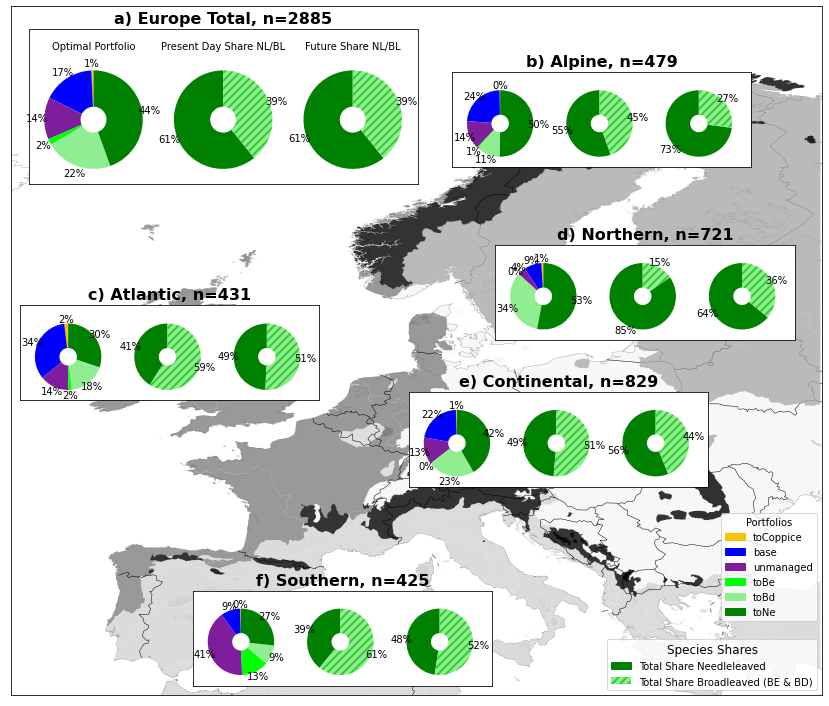

did not find a region for 0 cells


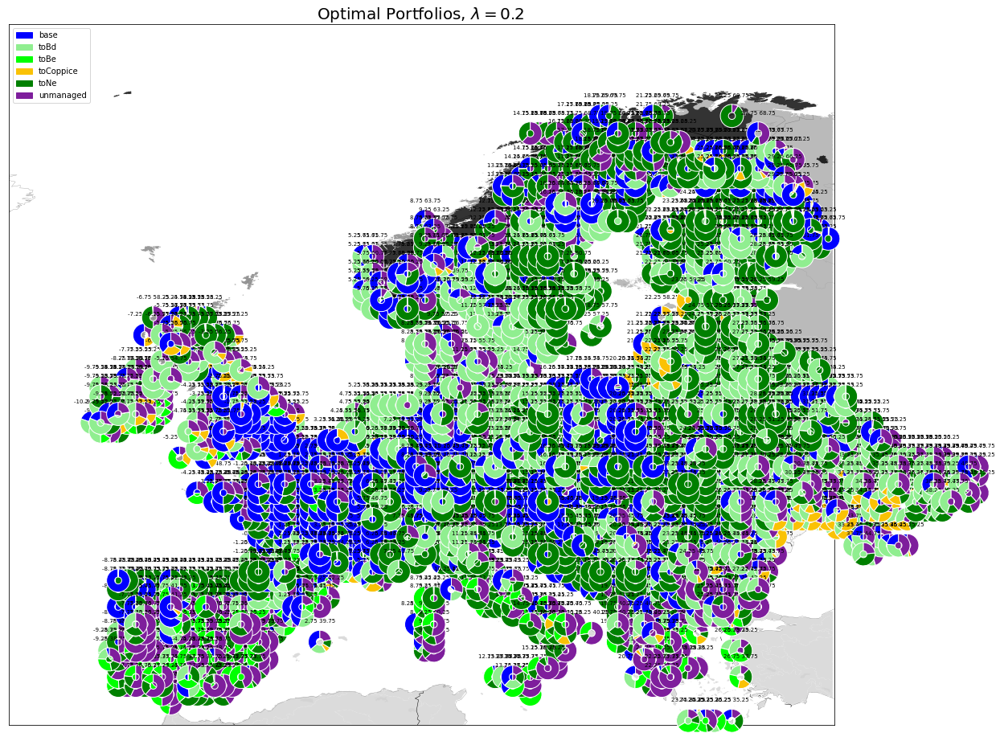

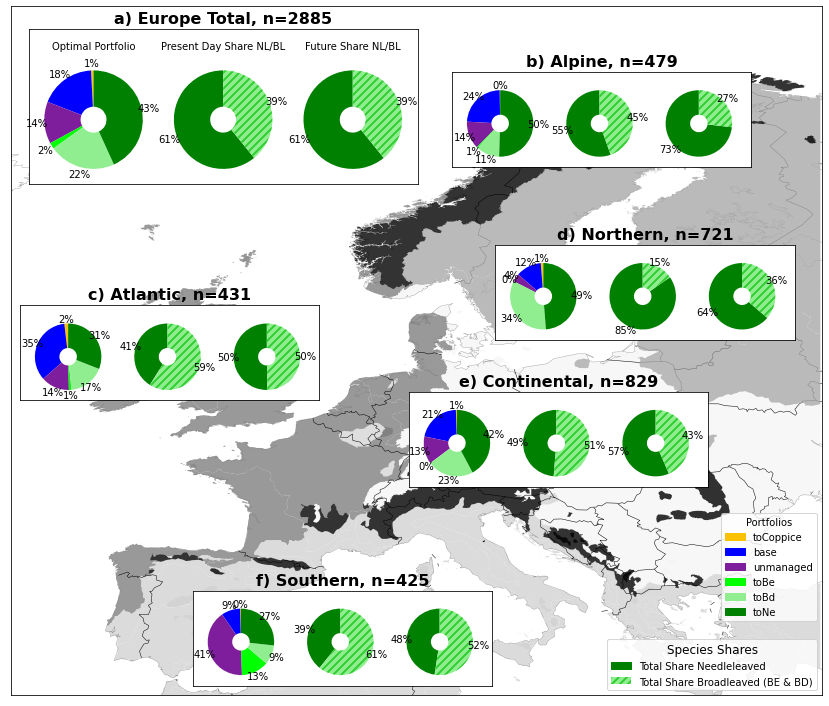

In [36]:
all_pfs_sum, shares_sum = plot_result(optimized_all_gcs_harvest_hlp_unmanaged_constraint)
all_pfs_maximin, shares_maximin = plot_result(optimized_all_gcs_harvest_hlp_unmanaged_constraint_minmax)

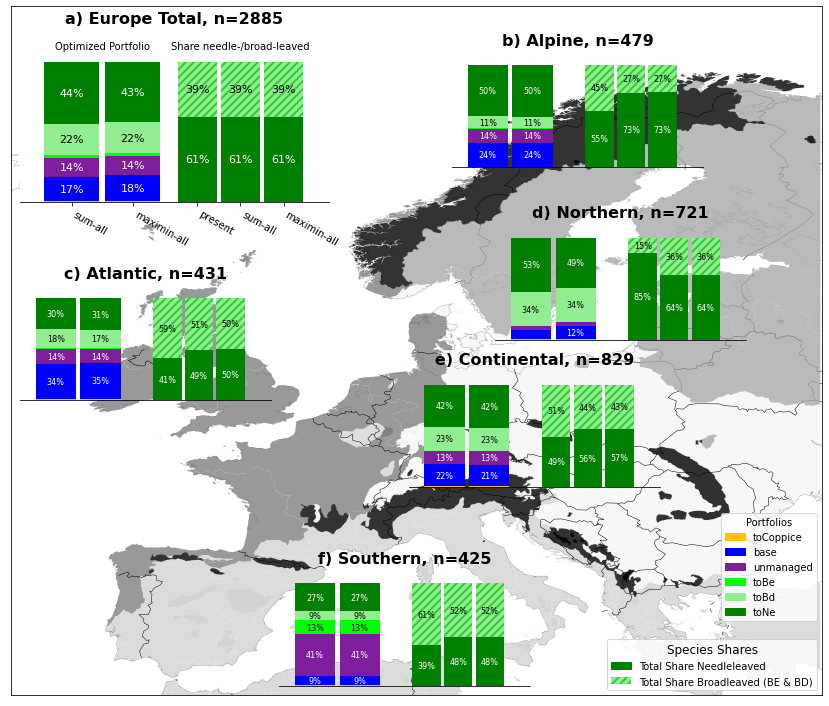

In [37]:
pffs = {
    'sum-all': all_pfs_sum,
    'maximin-all': all_pfs_maximin,
}

shares2 = ep.plot_europe_with_bars_and_compare(pffs, save_for_paper_path='supplement_figs/sum_vs_minmax_all.png')

It looks basically the same, with tiny differences. Let's check the performances:

In [38]:
gc_performances_sum = []
gc_performances_minmax = []


def get_performance(cell_out):
    portfolio = cell_out['all_rcp_solution_new'].x[1:]
    # objective function is z + omegas
    gc_worst_case = 1 - cell_out['all_rcp_solution_new'].x[0]
    gc_average_performances = np.dot(portfolio, cell_out['es_vals_all_rcps_new'].sum(axis=0) / 28)
    return 0.8 * gc_worst_case + 0.2 * gc_average_performances

different_results = 0

cells_with_zero_perf = 0

for cell_out_sum, cell_out_minmax in zip(optimized_all_gcs_harvest_hlp_unmanaged_constraint, optimized_all_gcs_harvest_hlp_unmanaged_constraint_minmax):

    gc_performances_sum.append(get_performance(cell_out_sum))
    gc_performances_minmax.append(get_performance(cell_out_minmax))

    if np.abs(gc_performances_minmax[-1] - gc_performances_sum[-1]) > 0.001:
        # oplot.plot_optimization_results2(cell_out_sum, luyssaert=False, radar=False, simulations_of_interest=run_optimization.used_simulations, save_to=None)
        # oplot.plot_optimization_results2(cell_out_minmax, luyssaert=False, radar=False, simulations_of_interest=run_optimization.used_simulations, save_to=None)
        different_results+=1

print('SUM WORST PERFORMANCE', np.min(gc_performances_sum))
print('MAXIMIN WORST PERFORMANCE', np.min(gc_performances_minmax))
print('SUM MEAN PERFORMANCE', np.mean(gc_performances_sum))
print('MAXIMIN MEAN PERFORMANCE', np.mean(gc_performances_minmax))
print('DIFFERENT CELLS', different_results)

SUM WORST PERFORMANCE 0.01903329343203091
MAXIMIN WORST PERFORMANCE 0.1346036435282232
SUM MEAN PERFORMANCE 0.4004603024567693
MAXIMIN MEAN PERFORMANCE 0.398709294630999
DIFFERENT CELLS 458


In [39]:
print('All plots done.')

All plots done.
